<a href="https://colab.research.google.com/github/gulsumaltintas/MachineLearning/blob/main/Senaryo_4_diabetes_prediction_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
df = pd.read_csv('/gdrive/My Drive/diabetes_prediction_dataset.csv')

In [ ]:
random_state = 1000

In [ ]:
df.head()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0


In [ ]:
df = pd.DataFrame(df)
df

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99995,Female,80.0,0,0,No Info,27.32,6.2,90,0
99996,Female,2.0,0,0,No Info,17.37,6.5,100,0
99997,Male,66.0,0,0,former,27.83,5.7,155,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   gender               100000 non-null  object 
 1   age                  100000 non-null  float64
 2   hypertension         100000 non-null  int64  
 3   heart_disease        100000 non-null  int64  
 4   smoking_history      100000 non-null  object 
 5   bmi                  100000 non-null  float64
 6   HbA1c_level          100000 non-null  float64
 7   blood_glucose_level  100000 non-null  int64  
 8   diabetes             100000 non-null  int64  
dtypes: float64(3), int64(4), object(2)
memory usage: 6.9+ MB


In [ ]:
df.shape

(100000, 9)

In [ ]:
df.isna().sum() #boş değer olmadığı için doldurma yapmaya gerek yok.

gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes               0
dtype: int64

In [ ]:
diabetes = np.where(df['blood_glucose_level']>100, 1, 0)

In [ ]:
pd.crosstab(diabetes,diabetes, normalize='all')*100

col_0,0,1
row_0,,
0,28.144,0.000
1,0.000,71.856


In [ ]:
df['diabetes'] = diabetes

df.drop('blood_glucose_level', axis=1, inplace=True)

df.columns

Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'diabetes'],
      dtype='object')

In [ ]:
categorical = ['gender','smoking_history']
#object olan kısımları category olarak değiştirecek
for col in categorical:
  df[col] = df[col].astype('category')

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype   
---  ------           --------------   -----   
 0   gender           100000 non-null  category
 1   age              100000 non-null  float64 
 2   hypertension     100000 non-null  int64   
 3   heart_disease    100000 non-null  int64   
 4   smoking_history  100000 non-null  category
 5   bmi              100000 non-null  float64 
 6   HbA1c_level      100000 non-null  float64 
 7   diabetes         100000 non-null  int64   
dtypes: category(2), float64(3), int64(3)
memory usage: 4.8 MB


In [ ]:
target_drop_columns_gender = {k:v for k, v in zip(df['gender'].unique(), list(range(len(df['gender'].unique()))))}

In [ ]:
target_drop_columns_gender

{'Female': 0, 'Male': 1, 'Other': 2}

In [ ]:
df['gender'] = df['gender'].map(target_drop_columns_gender)

In [ ]:
df.head()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,diabetes
0,0,80.0,0,1,never,25.19,6.6,1
1,0,54.0,0,0,No Info,27.32,6.6,0
2,1,28.0,0,0,never,27.32,5.7,1
3,0,36.0,0,0,current,23.45,5.0,1
4,1,76.0,1,1,current,20.14,4.8,1


In [ ]:
target_drop_columns_smoking = {k:v for k, v in zip(df['smoking_history'].unique(), list(range(len(df['smoking_history'].unique()))))}
target_drop_columns_smoking

{'never': 0,
 'No Info': 1,
 'current': 2,
 'former': 3,
 'ever': 4,
 'not current': 5}

In [ ]:
df['smoking_history'] = df['smoking_history'].map(target_drop_columns_smoking)
df

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,diabetes
0,0,80.0,0,1,0,25.19,6.6,1
1,0,54.0,0,0,1,27.32,6.6,0
2,1,28.0,0,0,0,27.32,5.7,1
3,0,36.0,0,0,2,23.45,5.0,1
4,1,76.0,1,1,2,20.14,4.8,1
...,...,...,...,...,...,...,...,...
99995,0,80.0,0,0,1,27.32,6.2,0
99996,0,2.0,0,0,1,17.37,6.5,0
99997,1,66.0,0,0,3,27.83,5.7,1
99998,0,24.0,0,0,0,35.42,4.0,0


In [ ]:
df.columns

Index(['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history',
       'bmi', 'HbA1c_level', 'diabetes'],
      dtype='object')

In [ ]:
df = pd.get_dummies(df, drop_first=True) #sütunlarda kaç özellik olduğunu görmek için.
df.columns

Index(['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
       'diabetes', 'gender_1', 'gender_2', 'smoking_history_2',
       'smoking_history_4', 'smoking_history_3', 'smoking_history_0',
       'smoking_history_5'],
      dtype='object')

In [ ]:
df.shape

(100000, 13)

In [ ]:
df = df.loc[df.age>45]
df = pd.DataFrame(df)
df = df.reset_index()
df.head()

,index,age,hypertension,heart_disease,bmi,HbA1c_level,diabetes,gender_1,gender_2,smoking_history_2,smoking_history_4,smoking_history_3,smoking_history_0,smoking_history_5
0,0,80.0,0,1,25.19,6.6,1,0,0,0,0,0,1,0
1,1,54.0,0,0,27.32,6.6,0,0,0,0,0,0,0,0
2,4,76.0,1,1,20.14,4.8,1,1,0,1,0,0,0,0
3,7,79.0,0,0,23.86,5.7,0,0,0,0,0,0,0,0
4,10,53.0,0,0,27.32,6.1,0,0,0,0,0,0,1,0


In [ ]:
df.head()

,index,age,hypertension,heart_disease,bmi,HbA1c_level,diabetes,gender_1,gender_2,smoking_history_2,smoking_history_4,smoking_history_3,smoking_history_0,smoking_history_5
0,0,80.0,0,1,25.19,6.6,1,0,0,0,0,0,1,0
1,1,54.0,0,0,27.32,6.6,0,0,0,0,0,0,0,0
2,4,76.0,1,1,20.14,4.8,1,1,0,1,0,0,0,0
3,7,79.0,0,0,23.86,5.7,0,0,0,0,0,0,0,0
4,10,53.0,0,0,27.32,6.1,0,0,0,0,0,0,1,0


In [ ]:
#45 Yas Üstü Hastaların Hastalık Tahmini için veri setimizdeki 45 yaş altındaki hastaları dahil etmeyeceğiz.

In [ ]:
from sklearn.preprocessing import StandardScaler

scale = StandardScaler()

df_sc = scale.fit_transform(df)
df_sc = pd.DataFrame(df_sc, columns=df.columns)

df_sc['diabetes'] = df['diabetes']

In [ ]:
df_sc.head()

,index,age,hypertension,heart_disease,bmi,HbA1c_level,diabetes,gender_1,gender_2,smoking_history_2,smoking_history_4,smoking_history_3,smoking_history_0,smoking_history_5
0,-1.730691,1.621667,-0.40528,3.343546,-0.646684,0.843844,1,-0.842371,-0.010412,-0.322616,-0.229879,-0.425234,1.340280,-0.288811
1,-1.730657,-0.768814,-0.40528,-0.299084,-0.282885,0.843844,0,-0.842371,-0.010412,-0.322616,-0.229879,-0.425234,-0.746113,-0.288811
2,-1.730553,1.253900,2.46743,3.343546,-1.509213,-0.739236,1,1.187125,-0.010412,3.099656,-0.229879,-0.425234,-0.746113,-0.288811
3,-1.730450,1.529725,-0.40528,-0.299084,-0.873845,0.052304,0,-0.842371,-0.010412,-0.322616,-0.229879,-0.425234,-0.746113,-0.288811
4,-1.730346,-0.860756,-0.40528,-0.299084,-0.282885,0.404100,0,-0.842371,-0.010412,-0.322616,-0.229879,-0.425234,1.340280,-0.288811


## **%80 - %20 şeklinde ayrılan veri seti tipi için sonuçları**

In [ ]:
y = df_sc['diabetes']

X = df_sc.drop('diabetes', axis=1)

from sklearn.model_selection import train_test_split

X_train, X_Test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=random_state)

**SVM**

In [ ]:
from sklearn.svm import SVC

SVM_classification = SVC()
SVM_classification.fit(X_train, y_train)

SVC()

In [ ]:
y_head = SVM_classification.predict(X_Test)

predictions = pd.DataFrame({'y_test': y_test,
                            'y_head': y_head})


In [ ]:
predictions

,y_test,y_head
24434,1,1
840,1,1
32445,1,1
35221,0,1
41003,1,1
...,...,...
32686,1,1
38906,1,1
28432,1,1
42297,1,1


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

svm_accuracy = accuracy_score(y_test, y_head)
svm_precision = precision_score(y_test, y_head)
svm_recall= recall_score(y_test, y_head)
svm_f1_score= f1_score(y_test, y_head)

**SVM Confusion Matrix**

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
svm_cm = confusion_matrix(y_test,y_head)
svm_cm

array([[   0, 2435],
       [   0, 6790]])

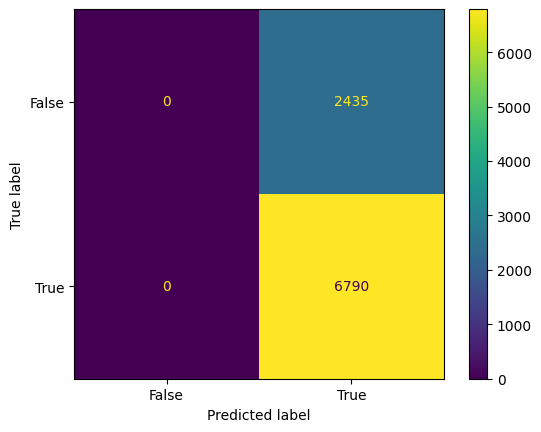

In [ ]:
from sklearn.metrics._plot.confusion_matrix import ConfusionMatrixDisplay
svm_confusion_matrix = metrics.confusion_matrix(y_test,y_head)


svm_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = svm_confusion_matrix, display_labels = [False, True])

svm_cm_display.plot()
plt.show()

**Random Forest**

In [ ]:
from sklearn.ensemble import RandomForestClassifier

random_forest = RandomForestClassifier()

random_forest.fit(X_train, y_train)

RandomForestClassifier()

In [ ]:
rf_prediction = random_forest.predict(X_Test)

In [ ]:
rf_accuracy= accuracy_score(y_test, rf_prediction)
rf_precision= precision_score(y_test, rf_prediction)
rf_recall= recall_score(y_test, rf_prediction)
rf_f1_score= f1_score(y_test, rf_prediction)

**Random Forest Confusion Matrix**

In [ ]:
rf_cm = confusion_matrix(y_test,rf_prediction)
rf_cm

array([[ 191, 2244],
       [ 445, 6345]])

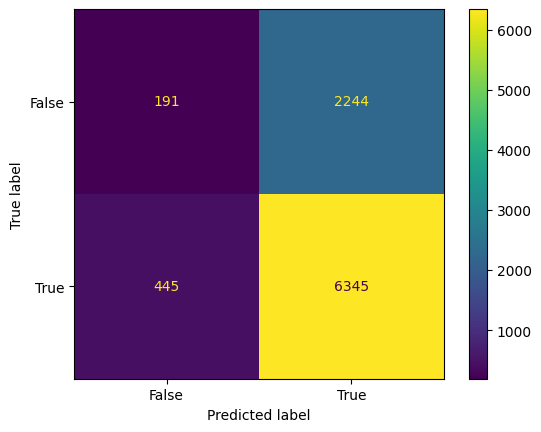

In [ ]:
rf_confusion_matrix = metrics.confusion_matrix(y_test,rf_prediction)


rf_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = rf_confusion_matrix, display_labels = [False, True])

rf_cm_display.plot()
plt.show()

**Decision Tree**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

decision_tree = DecisionTreeClassifier()

decision_tree.fit(X_train, y_train)
dt_predict = decision_tree.predict(X_Test)

dtree_accuracy= accuracy_score(y_test, dt_predict)
dtree_precision= precision_score(y_test, dt_predict)
dtree_recall= recall_score(y_test, dt_predict)
dtree_f1_score= f1_score(y_test, dt_predict)

**Decision Tree Confusion Matrix**

In [ ]:
dt_cm = confusion_matrix(y_test,dt_predict)
dt_cm

array([[ 706, 1729],
       [1877, 4913]])

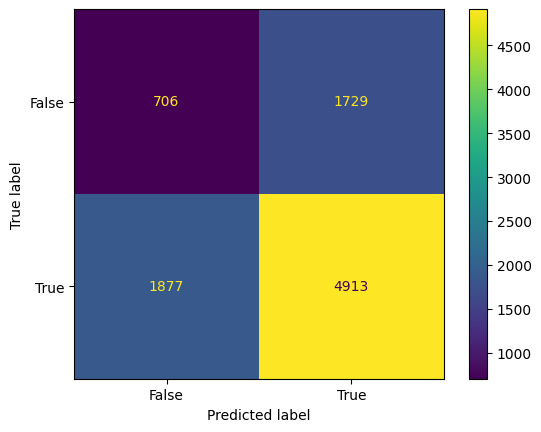

In [ ]:
dt_confusion_matrix = metrics.confusion_matrix(y_test,dt_predict)


dt_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = dt_confusion_matrix, display_labels = [False, True])

dt_cm_display.plot()
plt.show()

**Naive Bayes**

In [ ]:
from sklearn.naive_bayes import GaussianNB

nb = GaussianNB()

nb.fit(X_train, y_train)
nb_predict = nb.predict(X_Test)


nb_accuracy= accuracy_score(y_test, nb_predict)
nb_precision= precision_score(y_test, nb_predict)
nb_recall= recall_score(y_test, nb_predict)
nb_f1_score= f1_score(y_test, nb_predict)

**Navive Bayes Confusion Matrix**

In [ ]:
nb_cm = confusion_matrix(y_test,nb_predict)
nb_cm

array([[   6, 2429],
       [  19, 6771]])

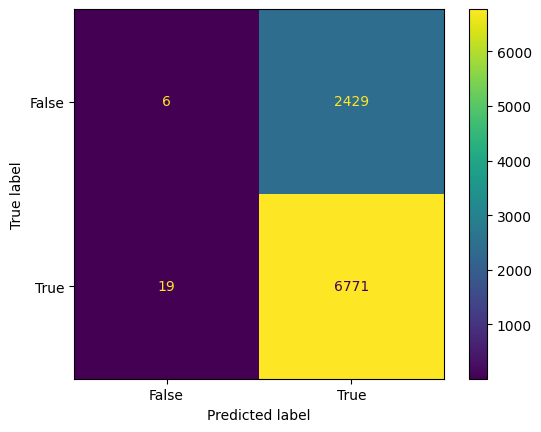

In [ ]:
nb_confusion_matrix = metrics.confusion_matrix(y_test,nb_predict)


nb_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = nb_confusion_matrix, display_labels = [False, True])

nb_cm_display.plot()
plt.show()

**Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression

logReg = LogisticRegression()

logReg.fit(X_train, y_train)
logReg_predict = logReg.predict(X_Test)

lr_accuracy= accuracy_score(y_test, logReg_predict)
lr_precision= precision_score(y_test, logReg_predict)
lr_recall= recall_score(y_test, logReg_predict)
lr_f1_score= f1_score(y_test, logReg_predict)

**Logistic Regression Confusion Matrix**

In [ ]:
lr_cm = confusion_matrix(y_test,logReg_predict)
lr_cm

array([[   0, 2435],
       [   0, 6790]])

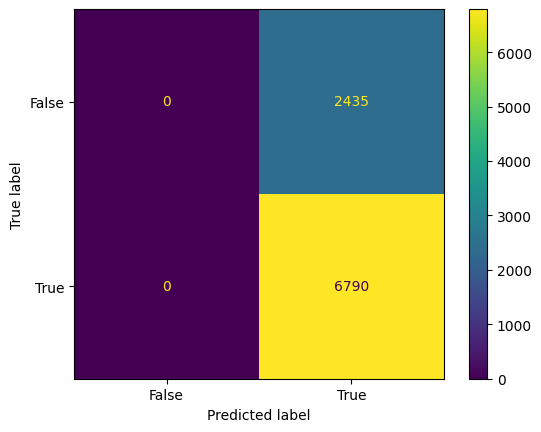

In [ ]:
lr_confusion_matrix = metrics.confusion_matrix(y_test,logReg_predict)


lr_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = lr_confusion_matrix, display_labels = [False, True])

lr_cm_display.plot()
plt.show()

**Multi–Layer Perceptron**

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier()

mlp.fit(X_train, y_train)

mlp_predicted = mlp.predict(X_Test)

mlp_accuracy= accuracy_score(y_test, mlp_predicted)
mlp_precision= precision_score(y_test, mlp_predicted)
mlp_recall= recall_score(y_test, mlp_predicted)
mlp_f1_score= f1_score(y_test, mlp_predicted)

**Multi-Layer Perceptron Confusion Matrix**

In [ ]:
mlp_cm = confusion_matrix(y_test,mlp_predicted)
mlp_cm

array([[   7, 2428],
       [  14, 6776]])

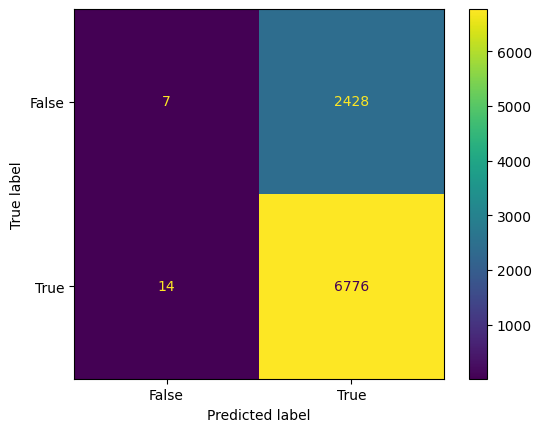

In [ ]:
mlp_confusion_matrix = metrics.confusion_matrix(y_test,mlp_predicted)


mlp_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = mlp_confusion_matrix, display_labels = [False, True])

mlp_cm_display.plot()
plt.show()

**K-Nearest Neighbor**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier()

knn.fit(X_train, y_train)
knn_predict = knn.predict(X_Test)

knn_accuracy= accuracy_score(y_test, knn_predict)
knn_precision= precision_score(y_test, knn_predict)
knn_recall= recall_score(y_test, knn_predict)
knn_f1_score= f1_score(y_test, knn_predict)

**K-Nearest Neighbor Confusion Matrix**

In [ ]:
knn_cm = confusion_matrix(y_test,knn_predict)
knn_cm

array([[ 356, 2079],
       [ 807, 5983]])

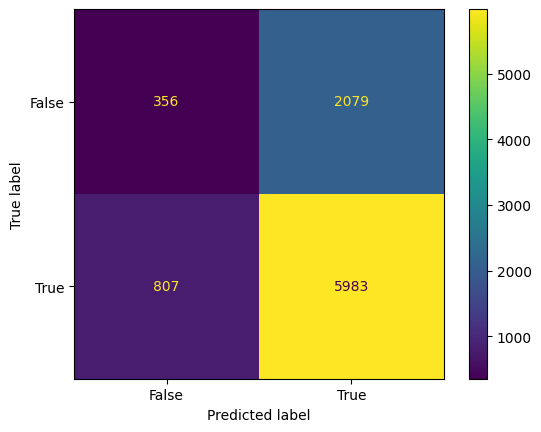

In [ ]:
knn_confusion_matrix = metrics.confusion_matrix(y_test,knn_predict)


knn_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = knn_confusion_matrix, display_labels = [False, True])

knn_cm_display.plot()
plt.show()

In [ ]:
tablo = {
    "Model": ["SVM","Random Forest","Decision Tree","Naive Bayes","Logistic Regression","Multi –Layer Perceptron","K-Nearest Neighbor"],
    "Accuracy": [svm_accuracy,rf_accuracy,dtree_accuracy,nb_accuracy,lr_accuracy,mlp_accuracy,knn_accuracy],
    "Precision": [svm_precision,rf_precision,dtree_precision,nb_precision,lr_precision,mlp_precision,knn_precision],
    "Recall": [svm_recall,rf_recall,dtree_recall,nb_recall,lr_recall,mlp_recall,knn_recall],
    "F1": [svm_f1_score,rf_f1_score,dtree_f1_score,nb_f1_score,lr_f1_score,mlp_f1_score,knn_f1_score]

    }

In [ ]:
pd.DataFrame(tablo)

,Model,Accuracy,Precision,Recall,F1
0,SVM,0.736043,0.736043,1.000000,0.847955
1,Random Forest,0.708509,0.738736,0.934462,0.825151
2,Decision Tree,0.609106,0.739687,0.723564,0.731537
3,Naive Bayes,0.734634,0.735978,0.997202,0.846904
4,Logistic Regression,0.736043,0.736043,1.000000,0.847955
5,Multi –Layer Perceptron,0.735285,0.736202,0.997938,0.847318
6,K-Nearest Neighbor,0.687154,0.742124,0.881149,0.805683


## **%75 - %25 şeklinde ayrılan veri seti tipi için sonuçları**

In [ ]:
X_train, X_Test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=random_state)

**SVM**

In [ ]:
from sklearn.svm import SVC

SVM_classification = SVC()
SVM_classification.fit(X_train, y_train)

SVC()

In [ ]:
y_head = SVM_classification.predict(X_Test)

predictions = pd.DataFrame({'y_test': y_test,
                            'y_head': y_head})
predictions

,y_test,y_head
24434,1,1
840,1,1
32445,1,1
35221,0,1
41003,1,1
...,...,...
36954,1,1
31195,1,1
11322,1,1
29290,1,1


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

svm_accuracy3 = accuracy_score(y_test, y_head)
svm_precision3 = precision_score(y_test, y_head)
svm_recall3= recall_score(y_test, y_head)
svm_f1_score3= f1_score(y_test, y_head)

**SVM Confusion Matrix**

In [ ]:
svm25_cm = confusion_matrix(y_test,y_head)
svm25_cm

array([[   0, 3056],
       [   0, 8475]])

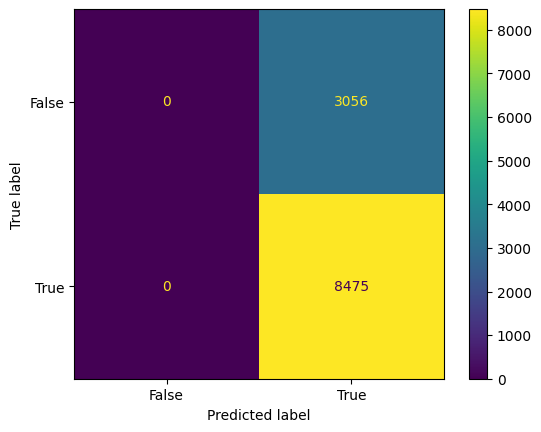

In [ ]:
svm25_confusion_matrix = metrics.confusion_matrix(y_test,y_head)


svm25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = svm25_confusion_matrix, display_labels = [False, True])

svm25_cm_display.plot()
plt.show()

**Random Forest**

In [ ]:
from sklearn.ensemble import RandomForestClassifier

random_forest = RandomForestClassifier()

random_forest.fit(X_train, y_train)
rf_prediction = random_forest.predict(X_Test)

rf_accuracy3= accuracy_score(y_test, rf_prediction)
rf_precision3= precision_score(y_test, rf_prediction)
rf_recall3= recall_score(y_test, rf_prediction)
rf_f1_score3= f1_score(y_test, rf_prediction)

**Random Forest Confusion Matrix**

In [ ]:
rf25_cm = confusion_matrix(y_test,rf_prediction)
rf25_cm

array([[ 240, 2816],
       [ 556, 7919]])

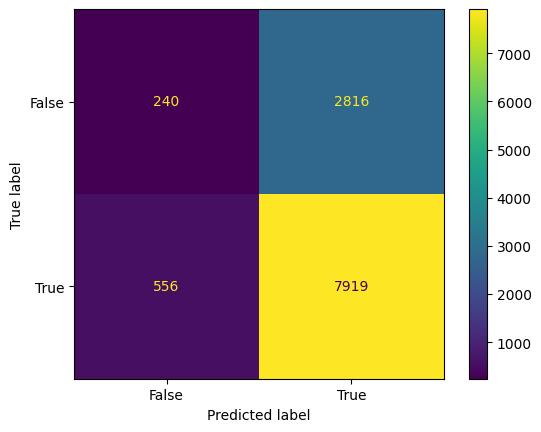

In [ ]:
rf25_confusion_matrix = metrics.confusion_matrix(y_test,rf_prediction)


rf25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = rf25_confusion_matrix, display_labels = [False, True])

rf25_cm_display.plot()
plt.show()

**Decision Tree**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

decision_tree = DecisionTreeClassifier()

decision_tree.fit(X_train, y_train)
dt_predict = decision_tree.predict(X_Test)

dtree_accuracy3= accuracy_score(y_test, dt_predict)
dtree_precision3= precision_score(y_test, dt_predict)
dtree_recall3= recall_score(y_test, dt_predict)
dtree_f1_score3= f1_score(y_test, dt_predict)

**Decion Tree Confusion Matrix**

In [ ]:
dt25_cm = confusion_matrix(y_test,dt_predict)
dt25_cm

array([[ 905, 2151],
       [2331, 6144]])

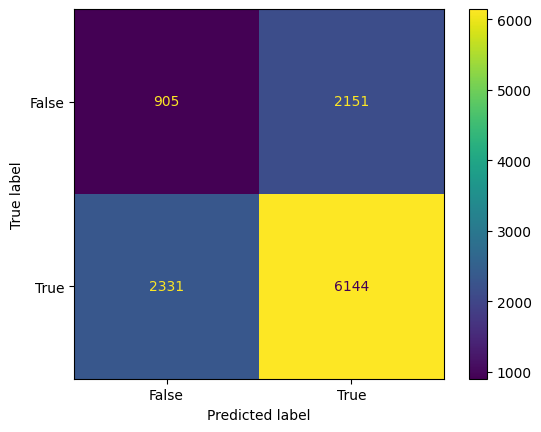

In [ ]:
dt25_confusion_matrix = metrics.confusion_matrix(y_test,dt_predict)


dt25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = dt25_confusion_matrix, display_labels = [False, True])

dt25_cm_display.plot()
plt.show()

**Naive Bayes**

In [ ]:
from sklearn.naive_bayes import GaussianNB

nb = GaussianNB()

nb.fit(X_train, y_train)
nb_predict = nb.predict(X_Test)


nb_accuracy3= accuracy_score(y_test, nb_predict)
nb_precision3= precision_score(y_test, nb_predict)
nb_recall3= recall_score(y_test, nb_predict)
nb_f1_score3= f1_score(y_test, nb_predict)

**Naive Bayes Confusion Matrix**

In [ ]:
nb25_cm = confusion_matrix(y_test,nb_predict)
nb25_cm

array([[   3, 3053],
       [   4, 8471]])

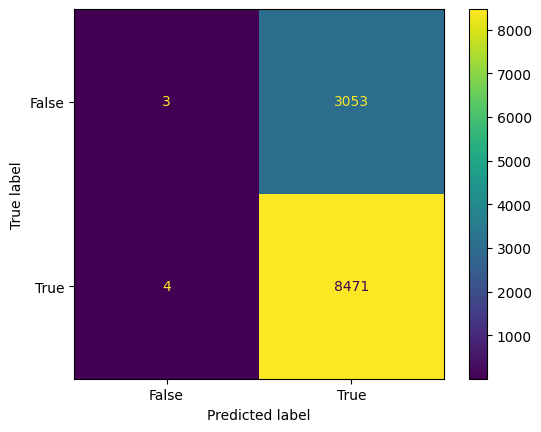

In [ ]:
nb25_confusion_matrix = metrics.confusion_matrix(y_test,nb_predict)


nb25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = nb25_confusion_matrix, display_labels = [False, True])

nb25_cm_display.plot()
plt.show()

**Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression

logReg = LogisticRegression()

logReg.fit(X_train, y_train)
logReg_predict = logReg.predict(X_Test)

lr_accuracy3= accuracy_score(y_test, logReg_predict)
lr_precision3= precision_score(y_test, logReg_predict)
lr_recall3= recall_score(y_test, logReg_predict)
lr_f1_score3= f1_score(y_test, logReg_predict)

**Logistic Regression Confusion Matrix**

In [ ]:
lr25_cm = confusion_matrix(y_test,logReg_predict)
lr25_cm

array([[   0, 3056],
       [   0, 8475]])

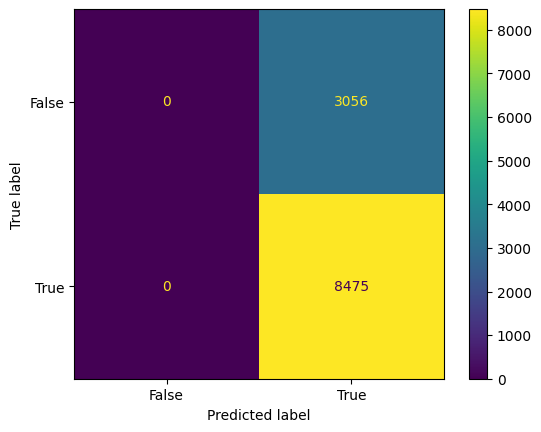

In [ ]:
lr25_confusion_matrix = metrics.confusion_matrix(y_test,logReg_predict)


lr25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = lr25_confusion_matrix, display_labels = [False, True])

lr25_cm_display.plot()
plt.show()

**Multi-Layer Perceptron**

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier()

mlp.fit(X_train, y_train)

mlp_predicted = mlp.predict(X_Test)

mlp_accuracy3= accuracy_score(y_test, mlp_predicted)
mlp_precision3= precision_score(y_test, mlp_predicted)
mlp_recall3= recall_score(y_test, mlp_predicted)
mlp_f1_score3= f1_score(y_test, mlp_predicted)

**Multi-Layer Perceptron Confusion Matrix**

In [ ]:
mlp25_cm = confusion_matrix(y_test,mlp_predicted)
mlp25_cm

array([[   2, 3054],
       [   9, 8466]])

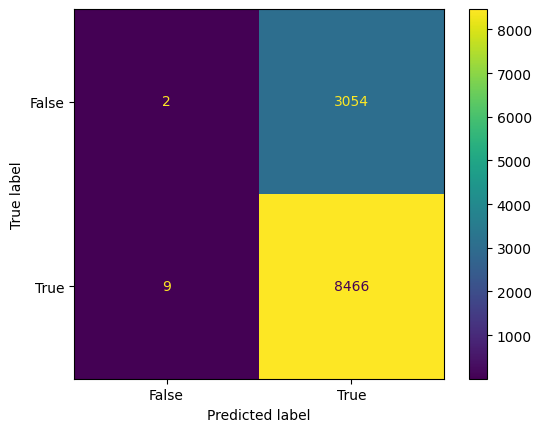

In [ ]:
mlp25_confusion_matrix = metrics.confusion_matrix(y_test,mlp_predicted)


mlp25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = mlp25_confusion_matrix, display_labels = [False, True])

mlp25_cm_display.plot()
plt.show()

**K-Nearest Neighbor**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier()

knn.fit(X_train, y_train)
knn_predict = knn.predict(X_Test)

knn_accuracy3= accuracy_score(y_test, knn_predict)
knn_precision3= precision_score(y_test, knn_predict)
knn_recall3= recall_score(y_test, knn_predict)
knn_f1_score3= f1_score(y_test, knn_predict)

**K-Nearest Neigbor Confusion Matrix**

In [ ]:
knn25_cm = confusion_matrix(y_test,knn_predict)
knn25_cm

array([[ 449, 2607],
       [ 987, 7488]])

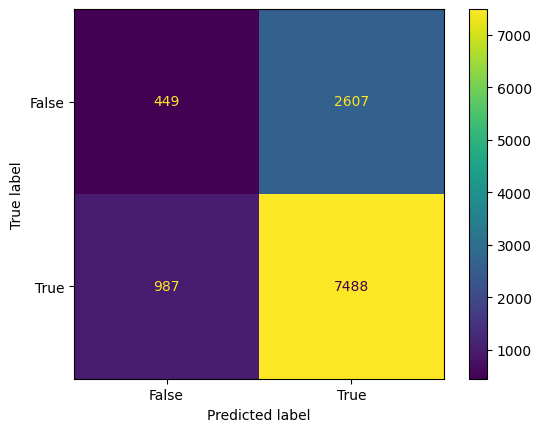

In [ ]:
knn25_confusion_matrix = metrics.confusion_matrix(y_test,knn_predict)


knn25_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = knn25_confusion_matrix, display_labels = [False, True])

knn25_cm_display.plot()
plt.show()

In [ ]:
tablo3 = {
    "Model": ["SVM","Random Forest","Decision Tree","Naive Bayes","Logistic Regression","Multi –Layer Perceptron","K-Nearest Neighbor"],
    "Accuracy": [svm_accuracy3,rf_accuracy3,dtree_accuracy3,nb_accuracy3,lr_accuracy3,mlp_accuracy3,knn_accuracy3],
    "Precision": [svm_precision3,rf_precision3,dtree_precision3,nb_precision3,lr_precision3,mlp_precision3,knn_precision3],
    "Recall": [svm_recall3,rf_recall3,dtree_recall3,nb_recall3,lr_recall3,mlp_recall3,knn_recall3],
    "F1": [svm_f1_score3,rf_f1_score3,dtree_f1_score3,nb_f1_score3,lr_f1_score3,mlp_f1_score3,knn_f1_score3]

    }

In [ ]:
pd.DataFrame(tablo3)

,Model,Accuracy,Precision,Recall,F1
0,SVM,0.734975,0.734975,1.000000,0.847246
1,Random Forest,0.707571,0.737680,0.934395,0.824466
2,Decision Tree,0.611309,0.740687,0.724956,0.732737
3,Naive Bayes,0.734889,0.735075,0.999528,0.847142
4,Logistic Regression,0.734975,0.734975,1.000000,0.847246
5,Multi –Layer Perceptron,0.734368,0.734896,0.998938,0.846812
6,K-Nearest Neighbor,0.688318,0.741753,0.883540,0.806462


## **%70 - %30 şeklinde ayrılan veri seti tipi için sonuçları**

In [ ]:
X_train, X_Test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=random_state)

**SVM**

In [ ]:
from sklearn.svm import SVC

SVM_classification = SVC()
SVM_classification.fit(X_train, y_train)

y_head = SVM_classification.predict(X_Test)

predictions = pd.DataFrame({'y_test': y_test,
                            'y_head': y_head})

predictions

,y_test,y_head
24434,1,1
840,1,1
32445,1,1
35221,0,1
41003,1,1
...,...,...
29158,1,1
11577,1,1
43643,1,1
32955,1,1


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

svm_accuracy2 = accuracy_score(y_test, y_head)
svm_precision2 = precision_score(y_test, y_head)
svm_recall2= recall_score(y_test, y_head)
svm_f1_score2= f1_score(y_test, y_head)

**SVM Confusion Matrix**

In [ ]:
svm30_cm = confusion_matrix(y_test,y_head)
svm30_cm

array([[    0,  3619],
       [    0, 10218]])

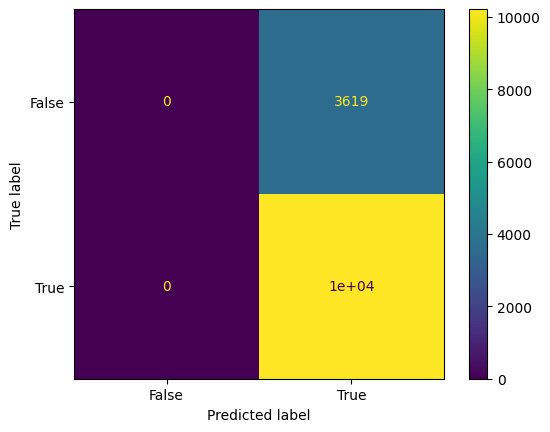

In [ ]:
svm30_confusion_matrix = metrics.confusion_matrix(y_test,y_head)


svm30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = svm30_confusion_matrix, display_labels = [False, True])

svm30_cm_display.plot()
plt.show()

**Random Forest**

In [ ]:
from sklearn.ensemble import RandomForestClassifier

random_forest = RandomForestClassifier()

random_forest.fit(X_train, y_train)
rf_prediction = random_forest.predict(X_Test)

rf_accuracy2= accuracy_score(y_test, rf_prediction)
rf_precision2= precision_score(y_test, rf_prediction)
rf_recall2= recall_score(y_test, rf_prediction)
rf_f1_score2= f1_score(y_test, rf_prediction)


**Random Forest Confusion Matrix**

In [ ]:
rf30_cm = confusion_matrix(y_test,rf_prediction)
rf30_cm

array([[ 282, 3337],
       [ 645, 9573]])

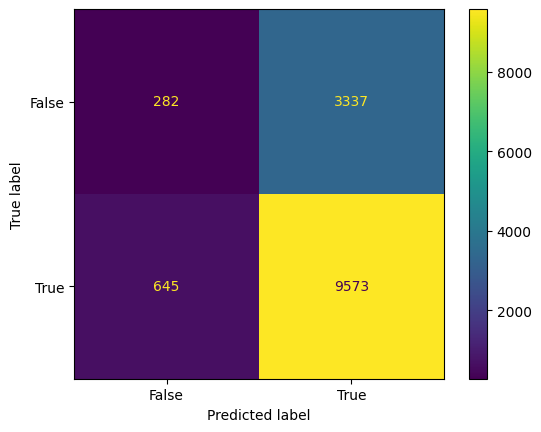

In [ ]:
rf30_confusion_matrix = metrics.confusion_matrix(y_test,rf_prediction)


rf30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = rf30_confusion_matrix, display_labels = [False, True])

rf30_cm_display.plot()
plt.show()

**Decision Tree**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

decision_tree = DecisionTreeClassifier()

decision_tree.fit(X_train, y_train)
dt_predict = decision_tree.predict(X_Test)

dtree_accuracy2= accuracy_score(y_test, dt_predict)
dtree_precision2= precision_score(y_test, dt_predict)
dtree_recall2= recall_score(y_test, dt_predict)
dtree_f1_score2= f1_score(y_test, dt_predict)

**Decision Tree Confusion Matrix**

In [ ]:
dt30_cm = confusion_matrix(y_test,dt_predict)
dt30_cm

array([[1093, 2526],
       [2717, 7501]])

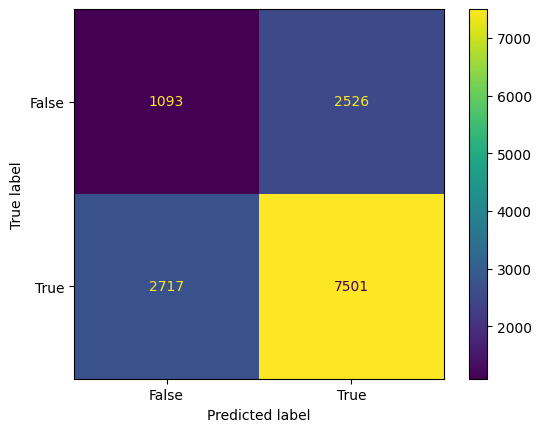

In [ ]:
dt30_confusion_matrix = metrics.confusion_matrix(y_test,dt_predict)


dt30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = dt30_confusion_matrix, display_labels = [False, True])

dt30_cm_display.plot()
plt.show()

**Naive Bayes**

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.naive_bayes import GaussianNB

nb = GaussianNB()

nb.fit(X_train, y_train)
nb_predict = nb.predict(X_Test)


nb_accuracy2= accuracy_score(y_test, nb_predict)
nb_precision2= precision_score(y_test, nb_predict)
nb_recall2= recall_score(y_test, nb_predict)
nb_f1_score2= f1_score(y_test, nb_predict)

**Naive Bayes Confusion Matrix**

In [ ]:
nb30_cm = confusion_matrix(y_test,nb_predict)
nb30_cm

array([[    6,  3613],
       [   14, 10204]])

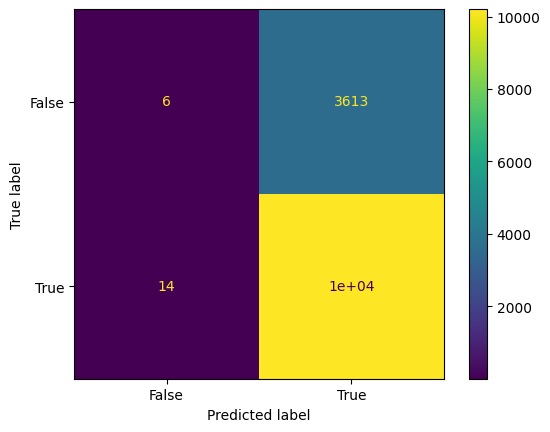

In [ ]:
nb30_confusion_matrix = metrics.confusion_matrix(y_test,nb_predict)


nb30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = nb30_confusion_matrix, display_labels = [False, True])

nb30_cm_display.plot()
plt.show()

**Logistic Regression**


In [ ]:
from sklearn.linear_model import LogisticRegression

logReg = LogisticRegression()

logReg.fit(X_train, y_train)
logReg_predict = logReg.predict(X_Test)

lr_accuracy2= accuracy_score(y_test, logReg_predict)
lr_precision2= precision_score(y_test, logReg_predict)
lr_recall2= recall_score(y_test, logReg_predict)
lr_f1_score2= f1_score(y_test, logReg_predict)

**Logistic Regression Confusion Matrix**

In [ ]:
lr30_cm = confusion_matrix(y_test,logReg_predict)
lr30_cm

array([[    0,  3619],
       [    0, 10218]])

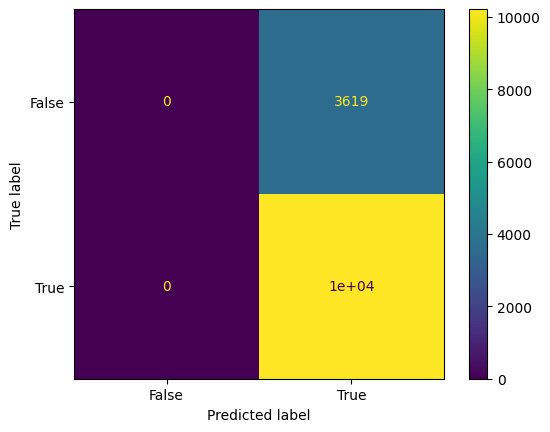

In [ ]:
lr30_confusion_matrix = metrics.confusion_matrix(y_test,logReg_predict)


lr30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = lr30_confusion_matrix, display_labels = [False, True])

lr30_cm_display.plot()
plt.show()

**Multi–Layer Perceptron**

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier()

mlp.fit(X_train, y_train)

mlp_predicted = mlp.predict(X_Test)

mlp_accuracy2= accuracy_score(y_test, mlp_predicted)
mlp_precision2= precision_score(y_test, mlp_predicted)
mlp_recall2= recall_score(y_test, mlp_predicted)
mlp_f1_score2= f1_score(y_test, mlp_predicted)

**Multi-Layer Perceptron Confusion Matrix**

In [ ]:
mlp30_cm = confusion_matrix(y_test,mlp_predicted)
mlp30_cm

array([[   11,  3608],
       [   15, 10203]])

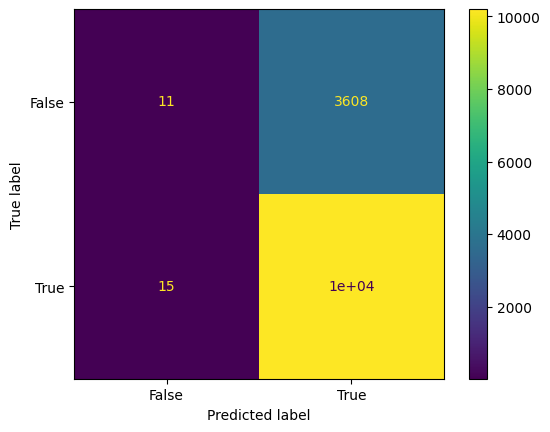

In [ ]:
mlp30_confusion_matrix = metrics.confusion_matrix(y_test,mlp_predicted)


mlp30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = mlp30_confusion_matrix, display_labels = [False, True])

mlp30_cm_display.plot()
plt.show()

**K-Nearest Neighbor**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier()

knn.fit(X_train, y_train)
knn_predict = knn.predict(X_Test)

knn_accuracy2= accuracy_score(y_test, knn_predict)
knn_precision2= precision_score(y_test, knn_predict)
knn_recall2= recall_score(y_test, knn_predict)
knn_f1_score2= f1_score(y_test, knn_predict)

**K-Nearest Neighbor Confusion Matrix**

In [ ]:
knn30_cm = confusion_matrix(y_test,knn_predict)
knn30_cm

array([[ 526, 3093],
       [1231, 8987]])

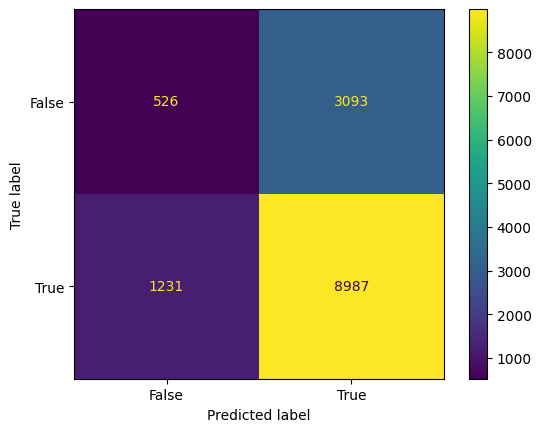

In [ ]:
knn30_confusion_matrix = metrics.confusion_matrix(y_test,knn_predict)


knn30_cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = knn30_confusion_matrix, display_labels = [False, True])

knn30_cm_display.plot()
plt.show()

In [ ]:
tablo2 = {
    "Model": ["SVM","Random Forest","Decision Tree","Naive Bayes","Logistic Regression","Multi –Layer Perceptron","K-Nearest Neighbor"],
    "Accuracy": [svm_accuracy2,rf_accuracy2,dtree_accuracy2,nb_accuracy2,lr_accuracy2,mlp_accuracy2,knn_accuracy2],
    "Precision": [svm_precision2,rf_precision2,dtree_precision2,nb_precision2,lr_precision2,mlp_precision2,knn_precision2],
    "Recall": [svm_recall2,rf_recall2,dtree_recall2,nb_recall2,lr_recall2,mlp_recall2,knn_recall2],
    "F1": [svm_f1_score2,rf_f1_score2,dtree_f1_score2,nb_f1_score2,lr_f1_score2,mlp_f1_score2,knn_f1_score2]

    }

In [ ]:
pd.DataFrame(tablo2)

,Model,Accuracy,Precision,Recall,F1
0,SVM,0.738455,0.738455,1.000000,0.849553
1,Random Forest,0.712221,0.741518,0.936876,0.827828
2,Decision Tree,0.621088,0.748080,0.734097,0.741022
3,Naive Bayes,0.737877,0.738511,0.998630,0.849095
4,Logistic Regression,0.738455,0.738455,1.000000,0.849553
5,Multi –Layer Perceptron,0.738166,0.738759,0.998532,0.849224
6,K-Nearest Neighbor,0.687505,0.743957,0.879526,0.806081


## **OPTİMİZASYON ALGORİTMALARI**

**%80-%20 olarak ayrılan veri setinin hiperparametre optimizasyonu**

In [ ]:
#Optimizasyon işlemi çok uzun sürdüğü için veri setimin ilk 100 elemanını optimizasyon işlemine sokarak optimizasyon gerçekleştirdim
y = y.head(100)
X = X.head(100)
X_train, X_Test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=random_state)

**K-Nearest Neighbor Optimization**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
import time

knn = KNeighborsClassifier()


param_grid_knn = {'n_neighbors':[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
                  'metric' : ['euclidean', 'manhattan', 'minkowski'],
                  'weights' : ['uniform', 'distance']}
start_time5 = time.time()

grid_knn = GridSearchCV(knn, param_grid_knn, verbose = 3,cv=5,n_jobs=-1)
grid_knn.fit(X_train, y_train)
end_time5 = time.time()

execution_time5 = end_time5 - start_time5


print("Optimizasyon süresi:", execution_time5, "saniye")

Fitting 5 folds for each of 180 candidates, totalling 900 fits
Optimizasyon süresi: 6.4867987632751465 saniye


In [ ]:
grid_knn.best_params_

{'metric': 'euclidean', 'n_neighbors': 3, 'weights': 'uniform'}

**Random Forest Optimization**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

rf = RandomForestClassifier()
random_grid= {
              'max_features' : ['auto', 'sqrt','log2'],
              'max_depth'  : [int(x) for x in np.linspace(10, 110, num = 11)],
              'min_samples_split' :[2, 5, 10],
              'min_samples_leaf' : [1, 2, 4],
              'bootstrap' : [True, False],
              'n_estimators': [2, 5, 10, 20],
              'criterion' : ['entropy', 'gini']
    }

start_time = time.time()
grid_rf = GridSearchCV(rf, random_grid, refit=True, verbose = 3, cv=5)
grid_rf.fit(X_train, y_train)

end_time = time.time()


execution_time = end_time - start_time


print("Optimizasyon süresi:", execution_time, "saniye")

Fitting 5 folds for each of 4752 candidates, totalling 23760 fits
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.562 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.62

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.250 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.68

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.87

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.87

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.62

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.250 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.5

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.438 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.3s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.4

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.3s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(



[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.250 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.938 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.625 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.875 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.250 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.938 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.312 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.3s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.3s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.3s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.3s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.5s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.312 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.938 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.562 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(



[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.2s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.562 total time=   0.2s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.625 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.312 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.625 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.938 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.312 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estima

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_esti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estima

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.3s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.625 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.688 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.375 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.750 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.250 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.562 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.688 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.812 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.438 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.625 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.625 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.875 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.688 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.875

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.750

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.688 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.688 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.875 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.688 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.688 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.750 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.875 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.688 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.688 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.750 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.750 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.688 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.812 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.750 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.625 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.875 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.750

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.812 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.812 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.625 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.750 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.812 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.750 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.812 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.688

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.812 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.812 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.812 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.750 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.438 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.562 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.688 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


In [ ]:
grid_rf.best_params_

{'bootstrap': True,
 'criterion': 'entropy',
 'max_depth': 20,
 'max_features': 'auto',
 'min_samples_leaf': 4,
 'min_samples_split': 10,
 'n_estimators': 2}

**Decision Tree Optimization**

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

param_grid = {'max_features': ['auto', 'sqrt','log2'],
              'ccp_alpha': [0.1, 0.01, 0.001],
              'max_depth': [5, 6, 7, 8],
              'criterion': ['entropy', 'gini'],
              'min_samples_leaf' : [3, 4, 5],
              'min_samples_split' :[2, 5, 10],
              'criterion' : ['entropy', 'gini']
            }

tree = DecisionTreeClassifier()
start_time2 = time.time()

grid = GridSearchCV(tree, param_grid, verbose=3,cv=5,n_jobs=-1)
grid.fit(X_train, y_train)
end_time2 = time.time()

execution_time2 = end_time2 - start_time2


print("Optimizasyon süresi:", execution_time2, "saniye")

Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Optimizasyon süresi: 17.012946367263794 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


In [ ]:
grid.best_params_

{'ccp_alpha': 0.1,
 'criterion': 'entropy',
 'max_depth': 5,
 'max_features': 'auto',
 'min_samples_leaf': 3,
 'min_samples_split': 2}

**Naive Bayes Optimization**

In [ ]:
from sklearn.naive_bayes import GaussianNB

import time

nb = GaussianNB()

param_grid_nb ={
    'var_smoothing': np.logspace(0,-9, num=100)
}
start_time3 = time.time()
grid_nb = GridSearchCV(nb,param_grid_nb,refit=True, verbose = 3, cv=5,n_jobs=-1)

grid_nb.fit(X_train,y_train)
end_time3 = time.time()

execution_time = end_time3 - start_time3


print("Optimizasyon süresi:", execution_time, "saniye")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 3.0812790393829346 saniye


In [ ]:
grid_nb.best_params_

{'var_smoothing': 1.0}

**Logistic Regression Optimization**

In [ ]:
from sklearn.linear_model import LogisticRegression
import time

lg = LogisticRegression()

params_lg ={
    'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'penalty' : ['none', 'l1', 'l2', 'elasticnet'],
    'C' : [100, 10, 1.0, 0.1, 0.01]
}
start_time7 = time.time()

grid_lg = GridSearchCV(lg, params_lg, refit=True, verbose = 3, cv=5,n_jobs=-1)
grid_lg.fit(X_train,y_train)
end_time7 = time.time()


execution_time7 = end_time7 - start_time7

print("Optimizasyon süresi:", execution_time7, "saniye")

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 2.5159177780151367 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
225 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 71, in _check_solver
    raise ValueError("penalty='none' 

In [ ]:
grid_lg.best_params_

{'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}

**Multi-Layer Perceptron Optimization**

In [ ]:
from sklearn.neural_network import MLPClassifier
import time

mlp = MLPClassifier()

params_mlp = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
    }
start_time6 = time.time()
grid_mlp = GridSearchCV(mlp, params_mlp, refit=True, verbose = 3, cv=5,n_jobs=-1)
grid_mlp.fit(X_train,y_train)

end_time6 = time.time()

execution_time6 = end_time6 - start_time6


print("Optimizasyon süresi:", execution_time6, "saniye")


Fitting 5 folds for each of 48 candidates, totalling 240 fits
Optimizasyon süresi: 42.43851375579834 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


In [ ]:
grid_mlp.best_params_

{'activation': 'tanh',
 'alpha': 0.0001,
 'hidden_layer_sizes': (50, 50, 50),
 'learning_rate': 'constant',
 'solver': 'sgd'}

**Support Vector Machine Optimization**

In [ ]:
from sklearn.svm import SVC
import time

param_grid = {'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['linear', 'rbf', 'poly', 'sigmoid']}
start_time8 = time.time()
grid_svm = GridSearchCV(SVC(), param_grid, refit=True, verbose = 3,cv=5,n_jobs=-1)

grid_svm.fit(X_train, y_train)
end_time8 = time.time()


execution_time8 = end_time8 - start_time8


print("Optimizasyon süresi:", execution_time8, "saniye")

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 25.653820037841797 saniye


In [ ]:
grid_svm.best_params_

{'C': 1, 'gamma': 0.1, 'kernel': 'poly'}

**%75-%25 olarak ayrılan veri setinin hiperparametre optimizasyonu**

In [ ]:
#Optimizasyon işlemi çok uzun sürdüğü için veri setimin ilk 100 elemanını optimizasyon işlemine sokarak optimizasyon gerçekleştirdim
y = y.head(100)
X = X.head(100)
X_train, X_Test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=random_state)

**Random Forest Optimization**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

rf = RandomForestClassifier()
random_grid= {
              'max_features' : ['auto', 'sqrt','log2'],
              'max_depth'  : [int(x) for x in np.linspace(10, 110, num = 11)],
              'min_samples_split' :[2, 5, 10],
              'min_samples_leaf' : [1, 2, 4],
              'bootstrap' : [True, False],
              'n_estimators': [2, 5, 10, 20],
              'criterion' : ['entropy', 'gini']
    }

start_time = time.time()
grid_rf = GridSearchCV(rf, random_grid, refit=True, verbose = 3, cv=5)
grid_rf.fit(X_train, y_train)

end_time = time.time()


execution_time = end_time - start_time


print("Optimizasyon süresi:", execution_time, "saniye")

Fitting 5 folds for each of 4752 candidates, totalling 23760 fits
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.933 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.4

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.73

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.4s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=1.000 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.66

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.60

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.80

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.600 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.933 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.9

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.467 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.80

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.467

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.933 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(



[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.267 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.533 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.200 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.933 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.3s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.3s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.933 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.333 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.933 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.133 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.3s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.2s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.933 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.3s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.3s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.600 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.2s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimat

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_esti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estima

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.3s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.533 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.933 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.400 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.533 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.600 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.333 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.2s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.3s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.3s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.2s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.3s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 total time=   0.2s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.3s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.2s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.3s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.2s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.3s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.3s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.667 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.267 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.533 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.400 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.867 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.667 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.467 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.667 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.867 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.733 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.667 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.400 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.600 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.467 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.733 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.600 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.667 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.800 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.800 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.533

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.467 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.600 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.667 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.600 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.733 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.733 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.733 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.733 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.933 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.800 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.733 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.600 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.733

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.800 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.667 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.533 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.867 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.933 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.733 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.800

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.800 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.800 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.667 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.733 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.867 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.800 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.533 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.333 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.733 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.600 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.667 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


In [ ]:
grid_rf.best_params_

{'bootstrap': True,
 'criterion': 'entropy',
 'max_depth': 110,
 'max_features': 'auto',
 'min_samples_leaf': 2,
 'min_samples_split': 10,
 'n_estimators': 5}

**Decision Tree Optimization**

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

param_grid = {'max_features': ['auto', 'sqrt','log2'],
              'ccp_alpha': [0.1, 0.01, 0.001],
              'max_depth': [5, 6, 7, 8],
              'criterion': ['entropy', 'gini'],
              'min_samples_leaf' : [3, 4, 5],
              'min_samples_split' :[2, 5, 10],
              'criterion' : ['entropy', 'gini']
            }

tree = DecisionTreeClassifier()
start_time2 = time.time()

grid = GridSearchCV(tree, param_grid, verbose=3,cv=5,n_jobs=-1)
grid.fit(X_train, y_train)
end_time2 = time.time()

execution_time2 = end_time2 - start_time2


print("Optimizasyon süresi:", execution_time2, "saniye")

Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Optimizasyon süresi: 18.870709896087646 saniye


In [ ]:
grid.best_params_

{'ccp_alpha': 0.01,
 'criterion': 'entropy',
 'max_depth': 8,
 'max_features': 'log2',
 'min_samples_leaf': 5,
 'min_samples_split': 5}

**K-Nearest Neighbor Optimization**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
import time

knn = KNeighborsClassifier()


param_grid_knn = {'n_neighbors':[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
                  'metric' : ['euclidean', 'manhattan', 'minkowski'],
                  'weights' : ['uniform', 'distance']}
start_time5 = time.time()

grid_knn = GridSearchCV(knn, param_grid_knn, verbose = 3,cv=5,n_jobs=-1)
grid_knn.fit(X_train, y_train)
end_time5 = time.time()

execution_time5 = end_time5 - start_time5


print("Optimizasyon süresi:", execution_time5, "saniye")

Fitting 5 folds for each of 180 candidates, totalling 900 fits
Optimizasyon süresi: 3.9693596363067627 saniye


In [ ]:
grid_knn.best_params_

{'metric': 'euclidean', 'n_neighbors': 11, 'weights': 'uniform'}

**Naive Bayes Optimization**

In [ ]:
from sklearn.naive_bayes import GaussianNB

import time

nb = GaussianNB()

param_grid_nb ={
    'var_smoothing': np.logspace(0,-9, num=100)
}
start_time3 = time.time()
grid_nb = GridSearchCV(nb,param_grid_nb,refit=True, verbose = 3, cv=5,n_jobs=-1)

grid_nb.fit(X_train,y_train)
end_time3 = time.time()

execution_time = end_time3 - start_time3


print("Optimizasyon süresi:", execution_time, "saniye")

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 1.926863431930542 saniye


In [ ]:
grid_nb.best_params_

{'var_smoothing': 1.0}

**Logistic Regression Optimization**

In [ ]:
from sklearn.linear_model import LogisticRegression
import time

lg = LogisticRegression()

params_lg ={
    'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'penalty' : ['none', 'l1', 'l2', 'elasticnet'],
    'C' : [100, 10, 1.0, 0.1, 0.01]
}
start_time7 = time.time()

grid_lg = GridSearchCV(lg, params_lg, refit=True, verbose = 3, cv=5,n_jobs=-1)
grid_lg.fit(X_train,y_train)
end_time7 = time.time()


execution_time7 = end_time7 - start_time7

print("Optimizasyon süresi:", execution_time7, "saniye")

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 2.715911388397217 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
225 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 71, in _check_solver
    raise ValueError("penalty='none' 

In [ ]:
grid_lg.best_params_

{'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}

**Multi-Layer Perceptron Optimization**

In [ ]:
from sklearn.neural_network import MLPClassifier
import time

mlp = MLPClassifier()

params_mlp = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
    }
start_time6 = time.time()
grid_mlp = GridSearchCV(mlp, params_mlp, refit=True, verbose = 3, cv=5,n_jobs=-1)
grid_mlp.fit(X_train,y_train)

end_time6 = time.time()

execution_time6 = end_time6 - start_time6


print("Optimizasyon süresi:", execution_time6, "saniye")

Fitting 5 folds for each of 48 candidates, totalling 240 fits
Optimizasyon süresi: 41.83215594291687 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


In [ ]:
grid_mlp.best_params_

{'activation': 'tanh',
 'alpha': 0.0001,
 'hidden_layer_sizes': (50, 50, 50),
 'learning_rate': 'constant',
 'solver': 'sgd'}

**Support Vector Optimization**

In [ ]:
from sklearn.svm import SVC
import time

param_grid = {'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['linear', 'rbf', 'poly', 'sigmoid']}
start_time8 = time.time()
grid_svm = GridSearchCV(SVC(), param_grid, refit=True, verbose = 3,cv=5,n_jobs=-1)

grid_svm.fit(X_train, y_train)
end_time8 = time.time()


execution_time8 = end_time8 - start_time8


print("Optimizasyon süresi:", execution_time8, "saniye")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 11.630840063095093 saniye


In [ ]:
grid_svm.best_params_

{'C': 0.1, 'gamma': 1, 'kernel': 'linear'}

**%70-%30 olarak ayrılan veri setinin hiperparametre optimizasyonu**

In [ ]:
#Optimizasyon işlemi çok uzun sürdüğü için veri setimin ilk 100 elemanını optimizasyon işlemine sokarak optimizasyon gerçekleştirdim
y = y.head(100)
X = X.head(100)
X_train, X_Test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=random_state)

**Random Forest Optimizasyon**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

rf = RandomForestClassifier()
random_grid= {
              'max_features' : ['auto', 'sqrt','log2'],
              'max_depth'  : [int(x) for x in np.linspace(10, 110, num = 11)],
              'min_samples_split' :[2, 5, 10],
              'min_samples_leaf' : [1, 2, 4],
              'bootstrap' : [True, False],
              'n_estimators': [2, 5, 10, 20],
              'criterion' : ['entropy', 'gini']
    }

start_time = time.time()
grid_rf = GridSearchCV(rf, random_grid, refit=True, verbose = 3, cv=5)
grid_rf.fit(X_train, y_train)

end_time = time.time()


execution_time = end_time - start_time


print("Optimizasyon süresi:", execution_time, "saniye")


Fitting 5 folds for each of 4752 candidates, totalling 23760 fits
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.71

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.85

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.357 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.85

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.92

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.3s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.2s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.42

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=1.000 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.500

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.429 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.5s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.85

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.5

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.6

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.71

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.85

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.4s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.3s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.3s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.3s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.929 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.929 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(



[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.571 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.571 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(



[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.357 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.929 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.429 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.286 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.357 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.929 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=  

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.357 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.571 total time=   0.0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.2s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.2s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=True, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(



[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.357 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, scor

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, sc

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, sco

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_esti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_est

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.929 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=1

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_esti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;,

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimator

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimato

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimat

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=entropy, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.571 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.357 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=20, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.571 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.929 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.357 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=30, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.929 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=50, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.571 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.929 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.429 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=60, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=70, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.929 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.643 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.500 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=80, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.714 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.643 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.500 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total tim

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.714 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total ti

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.500 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.714 

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.714

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.929 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.929 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 tot

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.357 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=100, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5;, score=0.643 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.643 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.643 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.714 t

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5;, score=0.643 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=20;, score=0.857

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.71

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score=0.714 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=20;, score

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor


[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.714 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=5;, score=0.857 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.714 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.643 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.571 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=2;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=5;, score=0.714 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=10;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=2;, score=0.714

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.7

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=2;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=5;, score=0.786 total

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.786 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=2;, score=0.857 to

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.786 tota

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.786 total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=20;, score=0.857 total time=   0.1s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=2;, score=0.714

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=5;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.78

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=10;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.1s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.786 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s


/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomFor

[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.1s
[CV 5/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=20;, score=0.857 total time=   0.0s
[CV 1/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 total time=   0.0s
[CV 2/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.643 total time=   0.0s
[CV 3/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.786 total time=   0.0s
[CV 4/5] END bootstrap=False, criterion=gini, max_depth=110, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=2;, score=0.571 t

In [ ]:
grid_rf.best_params_

{'bootstrap': False,
 'criterion': 'gini',
 'max_depth': 110,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 10,
 'n_estimators': 20}

**Decision Tree Optimization**

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

param_grid = {'max_features': ['auto', 'sqrt','log2'],
              'ccp_alpha': [0.1, 0.01, 0.001],
              'max_depth': [5, 6, 7, 8],
              'criterion': ['entropy', 'gini'],
              'min_samples_leaf' : [3, 4, 5],
              'min_samples_split' :[2, 5, 10],
              'criterion' : ['entropy', 'gini']
            }

tree = DecisionTreeClassifier()
start_time2 = time.time()

grid = GridSearchCV(tree, param_grid, verbose=3,cv=5,n_jobs=-1)
grid.fit(X_train, y_train)
end_time2 = time.time()

execution_time2 = end_time2 - start_time2


print("Optimizasyon süresi:", execution_time2, "saniye")


Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Optimizasyon süresi: 77.4471914768219 saniye


In [ ]:
grid.best_params_

{'ccp_alpha': 0.001,
 'criterion': 'entropy',
 'max_depth': 6,
 'max_features': 'log2',
 'min_samples_leaf': 4,
 'min_samples_split': 2}

**Naive Bayes Optimization**

In [ ]:
import time


nb = GaussianNB()

param_grid_nb ={
    'var_smoothing': np.logspace(0,-9, num=100)
}
start_time3 = time.time()
grid_nb = GridSearchCV(nb,param_grid_nb,refit=True, verbose = 3, cv=5,n_jobs=-1)

grid_nb.fit(X_train,y_train)
end_time3 = time.time()

execution_time = end_time3 - start_time3


print("Optimizasyon süresi:", execution_time, "saniye")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 11.02842116355896 saniye


In [ ]:
grid_nb.best_params_

{'var_smoothing': 1.0}


**K-Nearest Neighbor Optimization**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
import time

knn = KNeighborsClassifier()


param_grid_knn = {'n_neighbors':[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
                  'metric' : ['euclidean', 'manhattan', 'minkowski'],
                  'weights' : ['uniform', 'distance']}
start_time5 = time.time()

grid_knn = GridSearchCV(knn, param_grid_knn, verbose = 3,cv=5,n_jobs=-1)
grid_knn.fit(X_train, y_train)
end_time5 = time.time()

execution_time5 = end_time5 - start_time5


print("Optimizasyon süresi:", execution_time5, "saniye")


Fitting 5 folds for each of 180 candidates, totalling 900 fits
Optimizasyon süresi: 2759.7979407310486 saniye


In [ ]:
grid_knn.best_params_

{'metric': 'manhattan', 'n_neighbors': 29, 'weights': 'uniform'}

**Logistic Regression Optimization**

In [ ]:
from sklearn.linear_model import LogisticRegression
import time

lg = LogisticRegression()

params_lg ={
    'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'penalty' : ['none', 'l1', 'l2', 'elasticnet'],
    'C' : [100, 10, 1.0, 0.1, 0.01]
}
start_time7 = time.time()

grid_lg = GridSearchCV(lg, params_lg, refit=True, verbose = 3, cv=5,n_jobs=-1)
grid_lg.fit(X_train,y_train)
end_time7 = time.time()


execution_time7 = end_time7 - start_time7

print("Optimizasyon süresi:", execution_time7, "saniye")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 2.616182327270508 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
225 fits failed out of a total of 500.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 71, in _check_solver
    raise ValueError("penalty='none' 

In [ ]:
grid_lg.best_params_

{'C': 1.0, 'penalty': 'l1', 'solver': 'liblinear'}

**Multi-Layer Perceptron Optimization**

In [ ]:
from sklearn.neural_network import MLPClassifier
import time

mlp = MLPClassifier()

params_mlp = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
    }
start_time6 = time.time()
grid_mlp = GridSearchCV(mlp, params_mlp, refit=True, verbose = 3, cv=5,n_jobs=-1)
grid_mlp.fit(X_train,y_train)

end_time6 = time.time()

execution_time6 = end_time6 - start_time6


print("Optimizasyon süresi:", execution_time6, "saniye")


Fitting 5 folds for each of 48 candidates, totalling 240 fits
Optimizasyon süresi: 42.75565958023071 saniye


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


In [ ]:
grid_mlp.best_params_

{'activation': 'tanh',
 'alpha': 0.0001,
 'hidden_layer_sizes': (50, 50, 50),
 'learning_rate': 'constant',
 'solver': 'sgd'}

**SVM Optimizasyonu**

In [ ]:
from sklearn.svm import SVC
import time

param_grid = {'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['linear', 'rbf', 'poly', 'sigmoid']}
start_time8 = time.time()
grid_svm = GridSearchCV(SVC(), param_grid, refit=True, verbose = 3,cv=5,n_jobs=-1)

grid_svm.fit(X_train, y_train)
end_time8 = time.time()


execution_time8 = end_time8 - start_time8


print("Optimizasyon süresi:", execution_time8, "saniye")


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Optimizasyon süresi: 38.898125648498535 saniye


In [ ]:
grid_svm.best_params_

{'C': 0.1, 'gamma': 1, 'kernel': 'linear'}